In [1]:
import pandas as pd
import numpy as np
import seaborn as sbn
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

### Import Data

In [11]:
transaction = pd.read_excel("D:/big data/final project/Dataset/dunnhumby - Breakfast at the Frat.xlsx", sheet_name="dh Transaction Data")
pd.concat([transaction.head(3), transaction.tail(3)])

,WEEK_END_DATE,STORE_NUM,UPC,UNITS,VISITS,HHS,SPEND,PRICE,BASE_PRICE,FEATURE,DISPLAY,TPR_ONLY
0,2009-01-14,367,1111009477,13,13,13,18.07,1.39,1.57,0,0,1
1,2009-01-14,367,1111009497,20,18,18,27.80,1.39,1.39,0,0,0
2,2009-01-14,367,1111009507,14,14,14,19.32,1.38,1.38,0,0,0
524947,2012-01-04,29159,88491201426,32,29,23,105.92,3.31,3.31,0,0,0
524948,2012-01-04,29159,88491201427,30,26,23,99.30,3.31,3.31,0,0,0
524949,2012-01-04,29159,88491212971,20,20,20,44.40,2.22,2.85,0,0,1


In [12]:
product = pd.read_excel("D:/big data/final project/Dataset/dunnhumby - Breakfast at the Frat.xlsx", sheet_name="dh Products Lookup")
pd.concat([product.head(3), product.tail(3)])

,UPC,DESCRIPTION,MANUFACTURER,CATEGORY,SUB_CATEGORY,PRODUCT_SIZE
0,1111009477,PL MINI TWIST PRETZELS,PRIVATE LABEL,BAG SNACKS,PRETZELS,15 OZ
1,1111009497,PL PRETZEL STICKS,PRIVATE LABEL,BAG SNACKS,PRETZELS,15 OZ
2,1111009507,PL TWIST PRETZELS,PRIVATE LABEL,BAG SNACKS,PRETZELS,15 OZ
55,88491201426,POST HNY BN OTS HNY RSTD,POST FOODS,COLD CEREAL,ADULT CEREAL,18 OZ
56,88491201427,POST FM SZ HNYBNCH OT ALM,POST FOODS,COLD CEREAL,ADULT CEREAL,18 OZ
57,88491212971,POST FRUITY PEBBLES,POST FOODS,COLD CEREAL,KIDS CEREAL,11 OZ


In [13]:
store = pd.read_excel("D:/big data/final project/Dataset/dunnhumby - Breakfast at the Frat.xlsx", sheet_name="dh Store Lookup")
pd.concat([store.head(3), store.tail(3)])

,STORE_ID,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_BASKETS
0,389,SILVERLAKE,ERLANGER,KY,17140,MAINSTREAM,408.0,46073,24766.807692
1,2277,ANDERSON TOWNE CTR,CINCINNATI,OH,17140,UPSCALE,NaN,81958,54052.519231
2,4259,WARSAW AVENUE,CINCINNATI,OH,17140,VALUE,NaN,48813,31177.333333
76,23067,WHIPP & BIGGER,KETTERING,OH,19380,MAINSTREAM,230.0,37319,14555.935897
77,27175,KATY,KATY,TX,26420,UPSCALE,NaN,50224,24901.948718
78,28909,MIDDLETOWN,MIDDLETOWN,OH,17140,MAINSTREAM,NaN,85876,28986.108974


### Data Dimension

In [14]:
print("Transaction: ", transaction.shape)
print("Product: ", product.shape)
print("Store: ", store.shape)

Transaction:  (524950, 12)
Product:  (58, 6)
Store:  (79, 9)


In [15]:
transaction.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 524950 entries, 0 to 524949
Data columns (total 12 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   WEEK_END_DATE  524950 non-null  datetime64[ns]
 1   STORE_NUM      524950 non-null  int64         
 2   UPC            524950 non-null  int64         
 3   UNITS          524950 non-null  int64         
 4   VISITS         524950 non-null  int64         
 5   HHS            524950 non-null  int64         
 6   SPEND          524950 non-null  float64       
 7   PRICE          524927 non-null  float64       
 8   BASE_PRICE     524765 non-null  float64       
 9   FEATURE        524950 non-null  int64         
 10  DISPLAY        524950 non-null  int64         
 11  TPR_ONLY       524950 non-null  int64         
dtypes: datetime64[ns](1), float64(3), int64(8)
memory usage: 48.1 MB


In [16]:
product.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 58 entries, 0 to 57
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   UPC           58 non-null     int64 
 1   DESCRIPTION   58 non-null     object
 2   MANUFACTURER  58 non-null     object
 3   CATEGORY      58 non-null     object
 4   SUB_CATEGORY  58 non-null     object
 5   PRODUCT_SIZE  58 non-null     object
dtypes: int64(1), object(5)
memory usage: 2.8+ KB


In [17]:
store.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79 entries, 0 to 78
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   STORE_ID                 79 non-null     int64  
 1   STORE_NAME               79 non-null     object 
 2   ADDRESS_CITY_NAME        79 non-null     object 
 3   ADDRESS_STATE_PROV_CODE  79 non-null     object 
 4   MSA_CODE                 79 non-null     int64  
 5   SEG_VALUE_NAME           79 non-null     object 
 6   PARKING_SPACE_QTY        27 non-null     float64
 7   SALES_AREA_SIZE_NUM      79 non-null     int64  
 8   AVG_WEEKLY_BASKETS       79 non-null     float64
dtypes: float64(2), int64(3), object(4)
memory usage: 5.7+ KB


### Descriptive Statistics

In [18]:
transaction[['UNITS','VISITS','HHS','SPEND','PRICE','BASE_PRICE']].describe()

,UNITS,VISITS,HHS,SPEND,PRICE,BASE_PRICE
count,524950.000000,524950.000000,524950.000000,524950.000000,524927.000000,524765.000000
mean,19.608256,17.167349,16.777282,53.200729,3.382174,3.602747
std,29.934184,24.740741,24.186299,68.180697,1.559303,1.631726
min,0.000000,1.000000,1.000000,0.000000,0.000000,0.550000
25%,4.000000,4.000000,4.000000,13.360000,2.360000,2.500000
50%,10.000000,9.000000,9.000000,31.920000,2.990000,3.170000
75%,24.000000,21.000000,21.000000,67.600000,4.490000,4.590000
max,1800.000000,1340.000000,1286.000000,2952.000000,11.460000,11.460000


In [19]:
store[['PARKING_SPACE_QTY', 'SALES_AREA_SIZE_NUM', 'AVG_WEEKLY_BASKETS']].describe()

,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_BASKETS
count,27.000000,79.000000,79.000000
mean,480.518519,49145.164557,24146.806232
std,403.659641,13512.452153,8720.396844
min,17.000000,10788.000000,10434.705128
25%,282.000000,43067.500000,17522.432692
50%,351.000000,48594.000000,24567.750000
75%,488.500000,55200.500000,29186.262821
max,1859.000000,86517.000000,54052.519231


In [20]:
store[['STORE_ID','STORE_NAME','ADDRESS_CITY_NAME','ADDRESS_STATE_PROV_CODE','MSA_CODE','SEG_VALUE_NAME']].astype('object').describe()

,STORE_ID,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME
count,79,79,79,79,79,79
unique,77,73,51,4,9,3
top,17627,HOUSTON,CINCINNATI,TX,17140,MAINSTREAM
freq,2,4,9,43,29,43


In [21]:
product.astype('object').describe()

,UPC,DESCRIPTION,MANUFACTURER,CATEGORY,SUB_CATEGORY,PRODUCT_SIZE
count,58,58,58,58,58,58
unique,58,55,17,4,7,31
top,1111009477,PL BL MINT ANTSPTC RINSE,PRIVATE LABEL,BAG SNACKS,PRETZELS,16 OZ
freq,1,2,12,15,15,9


### Skewness

In [22]:
transaction[['UNITS', 'VISITS', 'HHS', 'SPEND', 'PRICE', 'BASE_PRICE']].skew()

UNITS         6.835946
VISITS        5.853763
HHS           5.798663
SPEND         4.760805
PRICE         0.762841
BASE_PRICE    0.733869
dtype: float64

In [23]:
store[['PARKING_SPACE_QTY', 'SALES_AREA_SIZE_NUM', 'AVG_WEEKLY_BASKETS']].skew()

PARKING_SPACE_QTY      2.322590
SALES_AREA_SIZE_NUM    0.480190
AVG_WEEKLY_BASKETS     0.890353
dtype: float64

#### Data Validation before Data Pre-Processing

##### Duplicate Records

In [24]:
# Check for duplicate records in each table
print("Duplicated rows in Transaction: ", sum(transaction.duplicated()))
print("Duplicated rows in Product: ", sum(product.duplicated()))
print("Duplicated rows in Store: ", sum(store.duplicated()))

Duplicated rows in Transaction:  0
Duplicated rows in Product:  0
Duplicated rows in Store:  0


In [25]:
store[store.duplicated(subset=['STORE_ID'], keep=False)]

,STORE_ID,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_BASKETS
22,4503,ROCKWALL,ROCKWALL,TX,19100,MAINSTREAM,NaN,56230,25289.326923
39,17627,FLOWER MOUND,FLOWER MOUND,TX,19100,MAINSTREAM,513.0,59213,18196.820513
54,17627,FLOWER MOUND,FLOWER MOUND,TX,19100,UPSCALE,513.0,59213,18196.820513
61,4503,ROCKWALL,ROCKWALL,TX,19100,UPSCALE,NaN,56230,25289.326923


In [26]:
store[store.duplicated(subset=['STORE_NAME'], keep=False)]

,STORE_ID,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_BASKETS
8,23327,HOUSTON,HOUSTON,TX,26420,MAINSTREAM,NaN,50722,30258.173077
12,623,HOUSTON,HOUSTON,TX,26420,MAINSTREAM,NaN,46930,36740.692308
20,21485,HOUSTON,KATY,TX,26420,MAINSTREAM,NaN,46369,26472.237179
22,4503,ROCKWALL,ROCKWALL,TX,19100,MAINSTREAM,NaN,56230,25289.326923
23,2513,HOUSTON,HOUSTON,TX,26420,UPSCALE,NaN,61833,32422.993590
39,17627,FLOWER MOUND,FLOWER MOUND,TX,19100,MAINSTREAM,513.0,59213,18196.820513
54,17627,FLOWER MOUND,FLOWER MOUND,TX,19100,UPSCALE,513.0,59213,18196.820513
55,21221,MIDDLETOWN,MIDDLETOWN,OH,17140,VALUE,NaN,48128,17009.897436
61,4503,ROCKWALL,ROCKWALL,TX,19100,UPSCALE,NaN,56230,25289.326923
78,28909,MIDDLETOWN,MIDDLETOWN,OH,17140,MAINSTREAM,NaN,85876,28986.108974


##### Missing Values

In [27]:
# Identify missing values in transaction data
transaction.isnull().sum()

WEEK_END_DATE      0
STORE_NUM          0
UPC                0
UNITS              0
VISITS             0
HHS                0
SPEND              0
PRICE             23
BASE_PRICE       185
FEATURE            0
DISPLAY            0
TPR_ONLY           0
dtype: int64

In [28]:
# Identify missing values in product data
product.isnull().sum()

UPC             0
DESCRIPTION     0
MANUFACTURER    0
CATEGORY        0
SUB_CATEGORY    0
PRODUCT_SIZE    0
dtype: int64

In [29]:
# Identify missing values in store data
store.isnull().sum()

STORE_ID                    0
STORE_NAME                  0
ADDRESS_CITY_NAME           0
ADDRESS_STATE_PROV_CODE     0
MSA_CODE                    0
SEG_VALUE_NAME              0
PARKING_SPACE_QTY          52
SALES_AREA_SIZE_NUM         0
AVG_WEEKLY_BASKETS          0
dtype: int64

##### Outliers

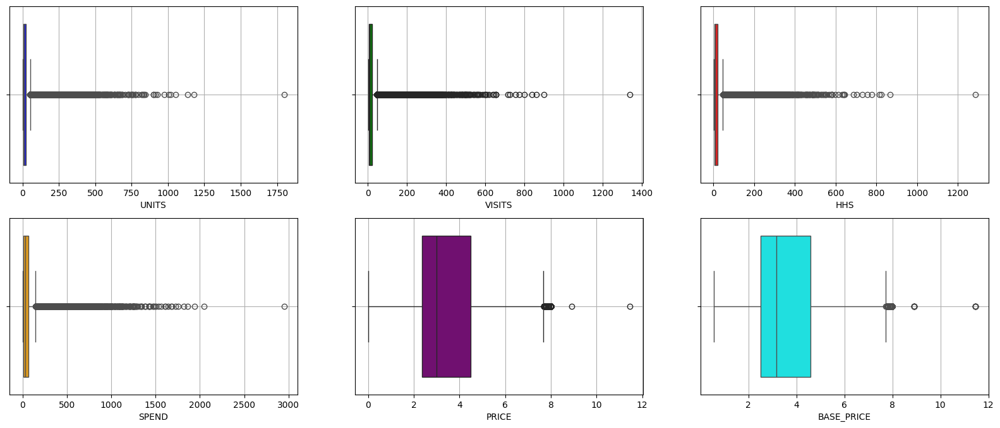

In [30]:
# Boxplots for transaction data
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 8))

sbn.boxplot(x=transaction['UNITS'], ax=ax[0, 0], color='blue')
ax[0, 0].grid(True)
sbn.boxplot(x=transaction['VISITS'], ax=ax[0, 1], color='green')
ax[0, 1].grid(True)
sbn.boxplot(x=transaction['HHS'], ax=ax[0, 2], color='red')
ax[0, 2].grid(True)
sbn.boxplot(x=transaction['SPEND'], ax=ax[1, 0], color='orange')
ax[1, 0].grid(True)
sbn.boxplot(x=transaction['PRICE'], ax=ax[1, 1], color='purple')
ax[1, 1].grid(True)
sbn.boxplot(x=transaction['BASE_PRICE'], ax=ax[1, 2], color='cyan')
ax[1, 2].grid(True)

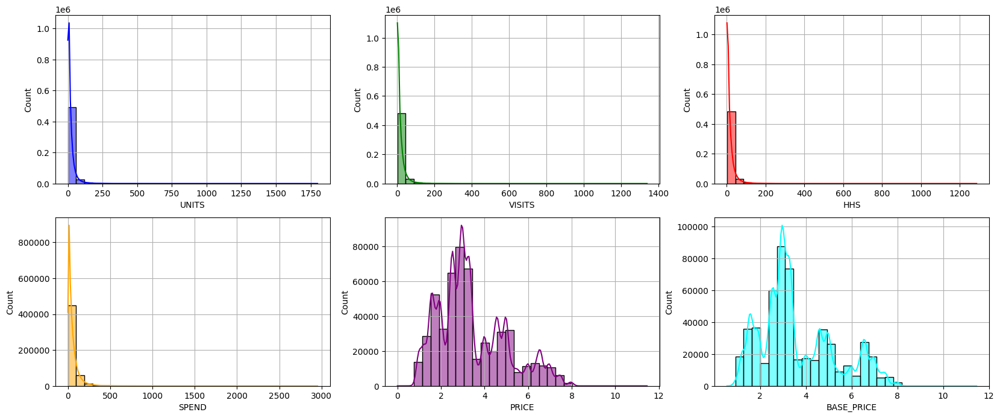

In [31]:
# Histograms for transaction data
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 8))

sbn.histplot(x=transaction['UNITS'], kde=True, bins=30, ax=ax[0, 0], color='blue')
ax[0, 0].grid(True)
sbn.histplot(x=transaction['VISITS'], kde=True, bins=30, ax=ax[0, 1], color='green')
ax[0, 1].grid(True)
sbn.histplot(x=transaction['HHS'], kde=True, bins=30, ax=ax[0, 2], color='red')
ax[0, 2].grid(True)
sbn.histplot(x=transaction['SPEND'], kde=True, bins=30, ax=ax[1, 0], color='orange')
ax[1, 0].grid(True)
sbn.histplot(x=transaction['PRICE'], kde=True, bins=30, ax=ax[1, 1], color='purple')
ax[1, 1].grid(True)
sbn.histplot(x=transaction['BASE_PRICE'], kde=True, bins=30, ax=ax[1, 2], color='cyan')
ax[1, 2].grid(True)

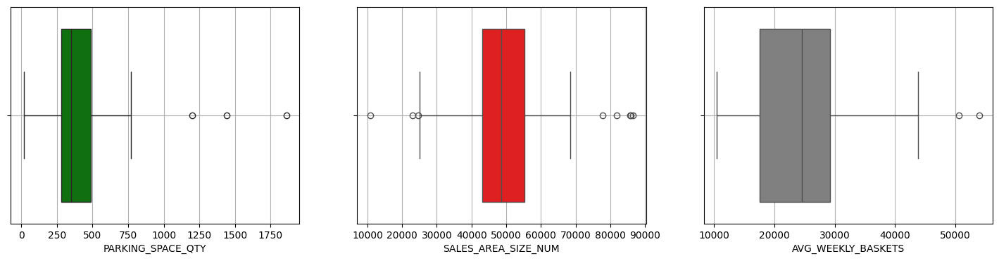

In [32]:
# Boxplots for store data
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(18, 4))

sbn.boxplot(x=store['PARKING_SPACE_QTY'], ax=ax[0], color='green')
ax[0].grid(True)
sbn.boxplot(x=store['SALES_AREA_SIZE_NUM'], ax=ax[1], color='red')
ax[1].grid(True)
sbn.boxplot(x=store['AVG_WEEKLY_BASKETS'], ax=ax[2], color='gray')
ax[2].grid(True)

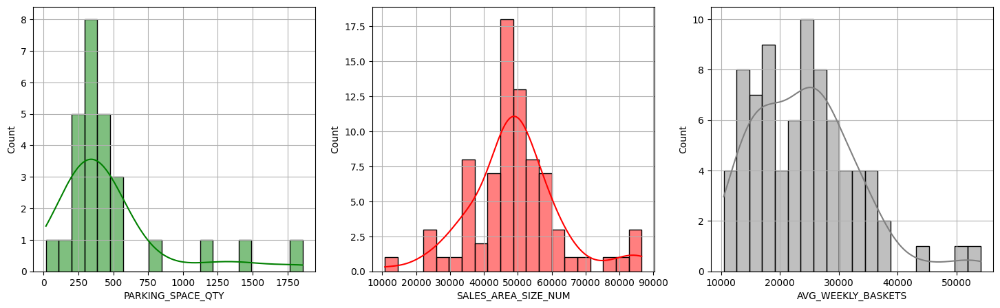

In [33]:
# Histograms for transaction data
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(18, 5))

sbn.histplot(x=store['PARKING_SPACE_QTY'], kde=True, bins=20, ax=ax[0], color='green')
ax[0].grid(True)
sbn.histplot(x=store['SALES_AREA_SIZE_NUM'], kde=True, bins=20, ax=ax[1], color='red')
ax[1].grid(True)
sbn.histplot(x=store['AVG_WEEKLY_BASKETS'], kde=True, bins=20, ax=ax[2], color='gray')
ax[2].grid(True)

### Data Preprocessing

##### Duplicate Records Remoal & Replace

In [34]:
fig1 = px.box(store, x='SEG_VALUE_NAME', y='SALES_AREA_SIZE_NUM', color='SEG_VALUE_NAME',
              category_orders={'SEG_VALUE_NAME': ['VALUE', 'MAINSTREAM', 'UPSCALE']}, title='SALES_AREA_SIZE_NUM Boxplot',height=400,width=600)
fig1.update_layout(yaxis=dict(showgrid=True, gridwidth=1, gridcolor='lightgrey'))
fig1.show()

fig2 = px.box(store, x='SEG_VALUE_NAME', y='AVG_WEEKLY_BASKETS', color='SEG_VALUE_NAME',
              category_orders={'SEG_VALUE_NAME': ['VALUE', 'MAINSTREAM', 'UPSCALE']}, title='AVG_WEEKLY_BASKETS Boxplot',height=400,width=600)
fig2.update_layout(yaxis=dict(showgrid=True, gridwidth=1, gridcolor='lightgrey'))
fig2.show()

In [35]:
# Remove store record with duplicate STORE_ID
store.drop([54,61], inplace=True)
print("Duplicate STORE_ID: ", sum(store['STORE_ID'].duplicated()))

Duplicate STORE_ID:  0


In [36]:
# Replace duplicate STORE_NAME for better idenification
store.loc[8, 'STORE_NAME'] = 'HOUSTON_23237'
store.loc[12, 'STORE_NAME'] = 'HOUSTON_623'
store.loc[20, 'STORE_NAME'] = 'HOUSTON_21485'
store.loc[23, 'STORE_NAME'] = 'HOUSTON_2513'
store.loc[55, 'STORE_NAME'] = 'MIDDLETOWN_21221'
store.loc[78, 'STORE_NAME'] = 'MIDDLETOWN_28909'
store.loc[[8,12,20,23,55,78]]

# Save the updated store records to excel file
#store.to_excel('Dataset/Store Details.xlsx', index=False)

,STORE_ID,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_BASKETS
8,23327,HOUSTON_23237,HOUSTON,TX,26420,MAINSTREAM,NaN,50722,30258.173077
12,623,HOUSTON_623,HOUSTON,TX,26420,MAINSTREAM,NaN,46930,36740.692308
20,21485,HOUSTON_21485,KATY,TX,26420,MAINSTREAM,NaN,46369,26472.237179
23,2513,HOUSTON_2513,HOUSTON,TX,26420,UPSCALE,NaN,61833,32422.993590
55,21221,MIDDLETOWN_21221,MIDDLETOWN,OH,17140,VALUE,NaN,48128,17009.897436
78,28909,MIDDLETOWN_28909,MIDDLETOWN,OH,17140,MAINSTREAM,NaN,85876,28986.108974


##### Data Integration

In [37]:
# Rename column before merging
transaction.rename(columns={'STORE_NUM': 'STORE_ID'}, inplace=True)

# Merge transaction with product data based on UPC
transaction_product_data = pd.merge(transaction, product, on='UPC', how='inner')

# Merge transaction_product_data with store data based on Store_ID
transaction_product_store_data = pd.merge(transaction_product_data, store, on='STORE_ID', how='inner')

# Sort the merged DataFrame by 'WEEK_END_DATE', 'STORE_ID', and 'UPC'
transaction_product_store_data.sort_values(by=['WEEK_END_DATE', 'STORE_ID', 'UPC'], inplace=True)
transaction_product_store_data.reset_index(drop=True, inplace=True)

transaction_product_store_data.shape

(524950, 25)

##### Attribute Rename

In [38]:
transaction_product_store_data.rename(columns={'UNITS': 'UNIT_SALES','SPEND': 'REVENUE', 'AVG_WEEKLY_BASKETS': 'AVG_WEEKLY_SALES'}, inplace=True)
transaction_product_store_data

,WEEK_END_DATE,STORE_ID,UPC,UNIT_SALES,VISITS,HHS,REVENUE,PRICE,BASE_PRICE,FEATURE,...,SUB_CATEGORY,PRODUCT_SIZE,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_SALES
0,2009-01-14,367,1111009477,13,13,13,18.07,1.39,1.57,0,...,PRETZELS,15 OZ,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
1,2009-01-14,367,1111009497,20,18,18,27.80,1.39,1.39,0,...,PRETZELS,15 OZ,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
2,2009-01-14,367,1111009507,14,14,14,19.32,1.38,1.38,0,...,PRETZELS,15 OZ,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
3,2009-01-14,367,1111035398,4,3,3,14.00,3.50,4.49,0,...,MOUTHWASHES (ANTISEPTIC),1.5 LT,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
4,2009-01-14,367,1111038078,3,3,3,7.50,2.50,2.50,0,...,MOUTHWASHES (ANTISEPTIC),500 ML,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
524945,2012-01-04,29159,31254742735,1,1,1,4.97,4.97,4.97,0,...,MOUTHWASHES (ANTISEPTIC),1 LT,CARROLLTON,CARROLLTON,TX,19100,MAINSTREAM,NaN,54927,25916.532051
524946,2012-01-04,29159,31254742835,5,5,5,24.85,4.97,4.97,0,...,MOUTHWASHES (ANTISEPTIC),1 LT,CARROLLTON,CARROLLTON,TX,19100,MAINSTREAM,NaN,54927,25916.532051
524947,2012-01-04,29159,88491201426,32,29,23,105.92,3.31,3.31,0,...,ADULT CEREAL,18 OZ,CARROLLTON,CARROLLTON,TX,19100,MAINSTREAM,NaN,54927,25916.532051
524948,2012-01-04,29159,88491201427,30,26,23,99.30,3.31,3.31,0,...,ADULT CEREAL,18 OZ,CARROLLTON,CARROLLTON,TX,19100,MAINSTREAM,NaN,54927,25916.532051


##### Missing Values Imputation (PRICE & BASE_PRICE)

In [39]:
# Create a copy of merged dataset called fmcg_sales_data
fmcg_sales_data = transaction_product_store_data.copy()

In [40]:
# Identify missing values in fmcg_sales_data
fmcg_sales_data.isnull().sum()

WEEK_END_DATE                   0
STORE_ID                        0
UPC                             0
UNIT_SALES                      0
VISITS                          0
HHS                             0
REVENUE                         0
PRICE                          23
BASE_PRICE                    185
FEATURE                         0
DISPLAY                         0
TPR_ONLY                        0
DESCRIPTION                     0
MANUFACTURER                    0
CATEGORY                        0
SUB_CATEGORY                    0
PRODUCT_SIZE                    0
STORE_NAME                      0
ADDRESS_CITY_NAME               0
ADDRESS_STATE_PROV_CODE         0
MSA_CODE                        0
SEG_VALUE_NAME                  0
PARKING_SPACE_QTY          359155
SALES_AREA_SIZE_NUM             0
AVG_WEEKLY_SALES                0
dtype: int64

In [41]:
# Check for common rows with missing values in both PRICE and BASE_PRICE
len(fmcg_sales_data[fmcg_sales_data['PRICE'].isnull() & fmcg_sales_data['BASE_PRICE'].isnull()])

0

In [42]:
# Rows with missing values in PRICE
fmcg_sales_data[fmcg_sales_data['PRICE'].isnull()]

,WEEK_END_DATE,STORE_ID,UPC,UNIT_SALES,VISITS,HHS,REVENUE,PRICE,BASE_PRICE,FEATURE,...,SUB_CATEGORY,PRODUCT_SIZE,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_SALES
21195,2009-02-25,25001,1111038078,1,1,1,0.0,NaN,2.59,0,...,MOUTHWASHES (ANTISEPTIC),500 ML,PINEWOOD,DAYTON,OH,19380,VALUE,351.0,34177,18034.967949
21196,2009-02-25,25001,1111038080,1,1,1,0.0,NaN,2.59,0,...,MOUTHWASHES (ANTISEPTIC),500 ML,PINEWOOD,DAYTON,OH,19380,VALUE,351.0,34177,18034.967949
25835,2009-03-11,11761,1111087396,1,1,1,0.0,NaN,3.87,0,...,PIZZA/PREMIUM,30.5 OZ,MIAMI TOWNSHIP,LOVELAND,OH,17140,UPSCALE,NaN,53905,23348.064103
64525,2009-06-03,23055,3700019521,1,1,1,0.0,NaN,3.49,0,...,MOUTHWASH/RINSES AND SPRAYS,4.2 OZ,WALNUT HILLS/PEEBLES,CINCINNATI,OH,17140,VALUE,239.0,22920,12999.724359
66221,2009-06-10,6187,31254742835,0,2,2,0.0,NaN,4.99,0,...,MOUTHWASHES (ANTISEPTIC),1 LT,ST. MARYS,SAINT MARYS,OH,47540,MAINSTREAM,NaN,55474,20015.320513
150740,2009-12-02,28909,31254742735,0,2,2,0.0,NaN,4.99,0,...,MOUTHWASHES (ANTISEPTIC),1 LT,MIDDLETOWN_28909,MIDDLETOWN,OH,17140,MAINSTREAM,NaN,85876,28986.108974
152090,2009-12-09,11967,31254742735,0,2,1,0.0,NaN,4.79,0,...,MOUTHWASHES (ANTISEPTIC),1 LT,NORTHBOROUGH SQ,HOUSTON,TX,26420,VALUE,294.0,25072,15915.743590
181398,2010-02-10,389,3700019521,0,2,2,0.0,NaN,3.49,0,...,MOUTHWASH/RINSES AND SPRAYS,4.2 OZ,SILVERLAKE,ERLANGER,KY,17140,MAINSTREAM,408.0,46073,24766.807692
200559,2010-03-17,21485,1111035398,1,1,1,0.0,NaN,3.17,0,...,MOUTHWASHES (ANTISEPTIC),1.5 LT,HOUSTON_21485,KATY,TX,26420,MAINSTREAM,NaN,46369,26472.237179
224231,2010-05-05,19523,3700044982,1,1,1,0.0,NaN,5.69,0,...,MOUTHWASHES (ANTISEPTIC),1 LT,DUNCANVILLE,DUNCANVILLE,TX,19100,VALUE,400.0,48594,24567.750000


In [43]:
# Examine if both PRICE and BASE_PRICE are same for other instances when FEATURE, DISPLAY, TPR_ONLY are 0
fmcg_sales_data[(fmcg_sales_data['FEATURE'] == 0) & (fmcg_sales_data['DISPLAY'] == 0) & (fmcg_sales_data['TPR_ONLY'] == 0)]

,WEEK_END_DATE,STORE_ID,UPC,UNIT_SALES,VISITS,HHS,REVENUE,PRICE,BASE_PRICE,FEATURE,...,SUB_CATEGORY,PRODUCT_SIZE,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_SALES
1,2009-01-14,367,1111009497,20,18,18,27.80,1.39,1.39,0,...,PRETZELS,15 OZ,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
2,2009-01-14,367,1111009507,14,14,14,19.32,1.38,1.38,0,...,PRETZELS,15 OZ,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
4,2009-01-14,367,1111038078,3,3,3,7.50,2.50,2.50,0,...,MOUTHWASHES (ANTISEPTIC),500 ML,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
5,2009-01-14,367,1111038080,2,2,2,5.18,2.59,2.59,0,...,MOUTHWASHES (ANTISEPTIC),500 ML,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
6,2009-01-14,367,1111085319,14,13,13,26.32,1.88,1.88,0,...,ALL FAMILY CEREAL,12.25 OZ,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
524944,2012-01-04,29159,31254742725,3,3,3,13.68,4.56,4.56,0,...,MOUTHWASHES (ANTISEPTIC),500 ML,CARROLLTON,CARROLLTON,TX,19100,MAINSTREAM,NaN,54927,25916.532051
524945,2012-01-04,29159,31254742735,1,1,1,4.97,4.97,4.97,0,...,MOUTHWASHES (ANTISEPTIC),1 LT,CARROLLTON,CARROLLTON,TX,19100,MAINSTREAM,NaN,54927,25916.532051
524946,2012-01-04,29159,31254742835,5,5,5,24.85,4.97,4.97,0,...,MOUTHWASHES (ANTISEPTIC),1 LT,CARROLLTON,CARROLLTON,TX,19100,MAINSTREAM,NaN,54927,25916.532051
524947,2012-01-04,29159,88491201426,32,29,23,105.92,3.31,3.31,0,...,ADULT CEREAL,18 OZ,CARROLLTON,CARROLLTON,TX,19100,MAINSTREAM,NaN,54927,25916.532051


In [44]:
# Impute missing values in PRICE with the same value as BASE_PRICE
fmcg_sales_data['PRICE'].fillna(fmcg_sales_data['BASE_PRICE'], inplace=True)

# Recalculate REVENUE based on PRICE and UNIT_SALES
fmcg_sales_data['REVENUE'] = fmcg_sales_data['PRICE'] * fmcg_sales_data['UNIT_SALES']

# Check top 3 rows after PRICE imputation
fmcg_sales_data.iloc[['21195', '21196', '25835']]

C:\Users\deepa\AppData\Local\Temp\ipykernel_20452\2107188390.py:2: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





,WEEK_END_DATE,STORE_ID,UPC,UNIT_SALES,VISITS,HHS,REVENUE,PRICE,BASE_PRICE,FEATURE,...,SUB_CATEGORY,PRODUCT_SIZE,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_SALES
21195,2009-02-25,25001,1111038078,1,1,1,2.59,2.59,2.59,0,...,MOUTHWASHES (ANTISEPTIC),500 ML,PINEWOOD,DAYTON,OH,19380,VALUE,351.0,34177,18034.967949
21196,2009-02-25,25001,1111038080,1,1,1,2.59,2.59,2.59,0,...,MOUTHWASHES (ANTISEPTIC),500 ML,PINEWOOD,DAYTON,OH,19380,VALUE,351.0,34177,18034.967949
25835,2009-03-11,11761,1111087396,1,1,1,3.87,3.87,3.87,0,...,PIZZA/PREMIUM,30.5 OZ,MIAMI TOWNSHIP,LOVELAND,OH,17140,UPSCALE,NaN,53905,23348.064103


In [45]:
# Rows with missing values in BASE_PRICE
fmcg_sales_data[fmcg_sales_data['BASE_PRICE'].isnull()]

,WEEK_END_DATE,STORE_ID,UPC,UNIT_SALES,VISITS,HHS,REVENUE,PRICE,BASE_PRICE,FEATURE,...,SUB_CATEGORY,PRODUCT_SIZE,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_SALES
542,2009-01-14,4245,1111087395,56,46,46,185.92,3.32,NaN,0,...,PIZZA/PREMIUM,32.7 OZ,LAWRENCEBURG,LAWRENCEBURG,IN,17140,MAINSTREAM,NaN,58563,19274.673077
543,2009-01-14,4245,1111087396,38,30,30,126.16,3.32,NaN,0,...,PIZZA/PREMIUM,30.5 OZ,LAWRENCEBURG,LAWRENCEBURG,IN,17140,MAINSTREAM,NaN,58563,19274.673077
544,2009-01-14,4245,1111087398,72,53,53,238.32,3.31,NaN,0,...,PIZZA/PREMIUM,29.6 OZ,LAWRENCEBURG,LAWRENCEBURG,IN,17140,MAINSTREAM,NaN,58563,19274.673077
590,2009-01-14,4259,1111087395,52,43,43,173.16,3.33,NaN,0,...,PIZZA/PREMIUM,32.7 OZ,WARSAW AVENUE,CINCINNATI,OH,17140,VALUE,NaN,48813,31177.333333
592,2009-01-14,4259,1111087398,52,39,38,176.28,3.39,NaN,0,...,PIZZA/PREMIUM,29.6 OZ,WARSAW AVENUE,CINCINNATI,OH,17140,VALUE,NaN,48813,31177.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
469329,2011-09-14,2279,2066200531,12,10,10,59.88,4.99,NaN,0,...,PIZZA/PREMIUM,13.3 OZ,MILFORD-MULBERRY,MILFORD,OH,17140,MAINSTREAM,771.0,44175,23037.442308
470723,2011-09-14,15541,2066200531,7,6,6,34.93,4.99,NaN,0,...,PIZZA/PREMIUM,13.3 OZ,LOVELAND,LOVELAND,OH,17140,MAINSTREAM,326.0,38858,18664.525641
482337,2011-10-12,367,2840002333,2,2,2,6.58,3.29,NaN,0,...,PRETZELS,10 OZ,15TH & MADISON,COVINGTON,KY,17140,VALUE,196.0,24721,12706.532051
490628,2011-10-26,15755,3700019521,1,1,1,2.49,2.49,NaN,1,...,MOUTHWASH/RINSES AND SPRAYS,4.2 OZ,KROGER JUNCTION S/C,PASADENA,TX,26420,VALUE,351.0,34373,18291.429487


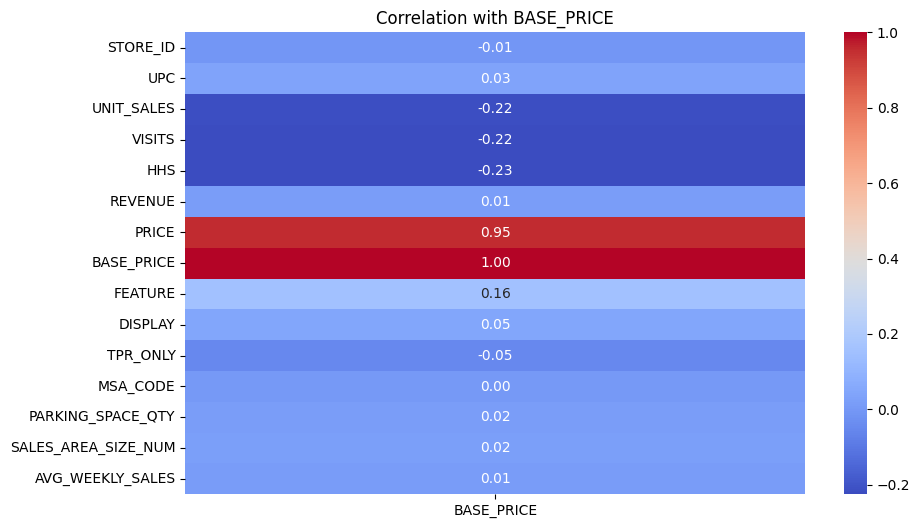

In [46]:
numeric_data = fmcg_sales_data.select_dtypes(include=['float64', 'int64'])
plt.figure(figsize=(10, 6))
sbn.heatmap(numeric_data.corr()[['BASE_PRICE']], annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation with BASE_PRICE')
plt.show()

In [47]:
base_price_median_by_price = fmcg_sales_data.groupby('PRICE')['BASE_PRICE'].median().reset_index()
base_price_median_by_price.columns = ['PRICE', 'MEDIAN_BASE_PRICE']
base_price_median_by_price
print(base_price_median_by_price[base_price_median_by_price['PRICE'] == 2.18])
print(base_price_median_by_price[base_price_median_by_price['PRICE'] == 1.99])

     PRICE  MEDIAN_BASE_PRICE
158   2.18               2.89
     PRICE  MEDIAN_BASE_PRICE
139   1.99               2.66


In [48]:
# Impute missing values in BASE_PRICE with the median of BASE_PRICE by corresponding PRICE values
fmcg_sales_data['BASE_PRICE'].fillna(fmcg_sales_data.groupby('PRICE')['BASE_PRICE'].transform('median'), inplace=True)

# Check top 3 rows after BASE_PRICE imputation
fmcg_sales_data.iloc[['542', '543', '544']]

C:\Users\deepa\AppData\Local\Temp\ipykernel_20452\541813535.py:2: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





,WEEK_END_DATE,STORE_ID,UPC,UNIT_SALES,VISITS,HHS,REVENUE,PRICE,BASE_PRICE,FEATURE,...,SUB_CATEGORY,PRODUCT_SIZE,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,PARKING_SPACE_QTY,SALES_AREA_SIZE_NUM,AVG_WEEKLY_SALES
542,2009-01-14,4245,1111087395,56,46,46,185.92,3.32,3.32,0,...,PIZZA/PREMIUM,32.7 OZ,LAWRENCEBURG,LAWRENCEBURG,IN,17140,MAINSTREAM,NaN,58563,19274.673077
543,2009-01-14,4245,1111087396,38,30,30,126.16,3.32,3.32,0,...,PIZZA/PREMIUM,30.5 OZ,LAWRENCEBURG,LAWRENCEBURG,IN,17140,MAINSTREAM,NaN,58563,19274.673077
544,2009-01-14,4245,1111087398,72,53,53,238.32,3.31,3.31,0,...,PIZZA/PREMIUM,29.6 OZ,LAWRENCEBURG,LAWRENCEBURG,IN,17140,MAINSTREAM,NaN,58563,19274.673077


##### Missing Values Removal (Drop PARKING_SPACE_QTY)

In [49]:
fmcg_sales_data.drop(columns=['PARKING_SPACE_QTY'], inplace=True)

##### Data Filtering (Removing Invalid Transaction Records)

In [50]:
invalid_rows = fmcg_sales_data[(fmcg_sales_data['PRICE'] == 0) | (fmcg_sales_data['UNIT_SALES'] == 0)]
invalid_rows

,WEEK_END_DATE,STORE_ID,UPC,UNIT_SALES,VISITS,HHS,REVENUE,PRICE,BASE_PRICE,FEATURE,...,CATEGORY,SUB_CATEGORY,PRODUCT_SIZE,STORE_NAME,ADDRESS_CITY_NAME,ADDRESS_STATE_PROV_CODE,MSA_CODE,SEG_VALUE_NAME,SALES_AREA_SIZE_NUM,AVG_WEEKLY_SALES
66221,2009-06-10,6187,31254742835,0,2,2,0.0,4.99,4.99,0,...,ORAL HYGIENE PRODUCTS,MOUTHWASHES (ANTISEPTIC),1 LT,ST. MARYS,SAINT MARYS,OH,47540,MAINSTREAM,55474,20015.320513
150740,2009-12-02,28909,31254742735,0,2,2,0.0,4.99,4.99,0,...,ORAL HYGIENE PRODUCTS,MOUTHWASHES (ANTISEPTIC),1 LT,MIDDLETOWN_28909,MIDDLETOWN,OH,17140,MAINSTREAM,85876,28986.108974
152090,2009-12-09,11967,31254742735,0,2,1,0.0,4.79,4.79,0,...,ORAL HYGIENE PRODUCTS,MOUTHWASHES (ANTISEPTIC),1 LT,NORTHBOROUGH SQ,HOUSTON,TX,26420,VALUE,25072,15915.743590
181398,2010-02-10,389,3700019521,0,2,2,0.0,3.49,3.49,0,...,ORAL HYGIENE PRODUCTS,MOUTHWASH/RINSES AND SPRAYS,4.2 OZ,SILVERLAKE,ERLANGER,KY,17140,MAINSTREAM,46073,24766.807692
246398,2010-06-23,367,7027316404,3,3,3,0.0,0.00,1.97,0,...,BAG SNACKS,PRETZELS,16 OZ,15TH & MADISON,COVINGTON,KY,17140,VALUE,24721,12706.532051
373945,2011-03-02,19521,3000006610,0,6,5,0.0,2.98,2.98,0,...,COLD CEREAL,KIDS CEREAL,14 OZ,SOUTHLAKE,SOUTHLAKE,TX,19100,UPSCALE,47757,14051.608974


In [51]:
# Filter data where instances have either 'UNIT_SALES' or 'PRICE' equals 0
fmcg_sales_data.drop(invalid_rows.index, inplace=True)
fmcg_sales_data.shape

(524944, 24)

##### Data Transformation

In [52]:
temp = fmcg_sales_data[(fmcg_sales_data['UNIT_SALES'] > 0) & (fmcg_sales_data['UNIT_SALES'] < 1)]
print("UNIT_SALES: ", "False" if temp.empty else "True")

temp = fmcg_sales_data[(fmcg_sales_data['VISITS'] > 0) & (fmcg_sales_data['VISITS'] < 1)]
print("VISITS: ", "False" if temp.empty else "True")

temp = fmcg_sales_data[(fmcg_sales_data['HHS'] > 0) & (fmcg_sales_data['HHS'] < 1)]
print("HHS: ", "False" if temp.empty else "True")

temp = fmcg_sales_data[(fmcg_sales_data['REVENUE'] > 0) & (fmcg_sales_data['REVENUE'] < 1)]
print("REVENUE: ", "False" if temp.empty else "True")

UNIT_SALES:  False
VISITS:  False
HHS:  False
REVENUE:  True


In [53]:
# Log Transformation
fmcg_sales_data['UNIT_SALES_LOG'] = np.log(fmcg_sales_data['UNIT_SALES'])
fmcg_sales_data['VISITS_LOG'] = np.log(fmcg_sales_data['VISITS'])
fmcg_sales_data['HHS_LOG'] = np.log(fmcg_sales_data['HHS'])
fmcg_sales_data['REVENUE_LOG'] = np.log(fmcg_sales_data['REVENUE'] + 1)   # Add constant 1 to avoid negative value of REVENUE_LOG

In [54]:
print(fmcg_sales_data['UNIT_SALES_LOG'].skew())
print(fmcg_sales_data['VISITS_LOG'].skew())
print(fmcg_sales_data['HHS_LOG'].skew())
print(fmcg_sales_data['REVENUE_LOG'].skew())

-0.06732377963539328
-0.04529651421386215
-0.03564056157874972
-0.025991084631762286


In [55]:
# Square Root Transformation
fmcg_sales_data['PRICE_SQRT'] = np.sqrt(fmcg_sales_data['PRICE'])
fmcg_sales_data['BASE_PRICE_SQRT'] = np.sqrt(fmcg_sales_data['BASE_PRICE'])
fmcg_sales_data['AVG_WEEKLY_SALES_SQRT'] = np.sqrt(fmcg_sales_data['AVG_WEEKLY_SALES'])

In [56]:
print(fmcg_sales_data['PRICE_SQRT'].skew())
print(fmcg_sales_data['BASE_PRICE_SQRT'].skew())
print(fmcg_sales_data['AVG_WEEKLY_SALES_SQRT'].skew())

0.29621804479007097
0.32239588368775085
0.3762852191019034


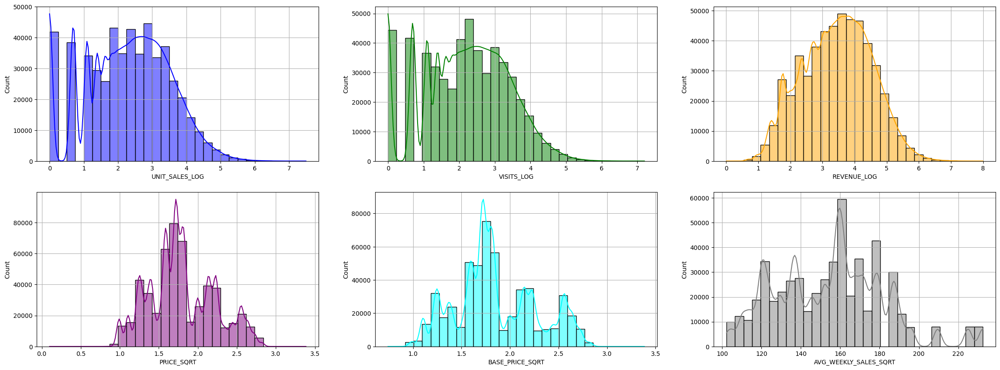

In [57]:
# Plot histogram  for log and sqrt transformed variables
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(28, 10))

sbn.histplot(x=fmcg_sales_data['UNIT_SALES_LOG'], kde=True, bins=30, ax=ax[0,0], color='blue')
ax[0,0].grid(True)
sbn.histplot(x=fmcg_sales_data['VISITS_LOG'], kde=True, bins=30, ax=ax[0,1], color='green')
ax[0,1].grid(True)
sbn.histplot(x=fmcg_sales_data['REVENUE_LOG'], kde=True, bins=30, ax=ax[0,2], color='orange')
ax[0,2].grid(True)

sbn.histplot(x=fmcg_sales_data['PRICE_SQRT'], kde=True, bins=30, ax=ax[1,0], color='purple')
ax[1,0].grid(True)
sbn.histplot(x=fmcg_sales_data['BASE_PRICE_SQRT'], kde=True, bins=30, ax=ax[1,1], color='cyan')
ax[1,1].grid(True)
sbn.histplot(x=fmcg_sales_data['AVG_WEEKLY_SALES_SQRT'], kde=True, bins=30, ax=ax[1,2], color='gray')
ax[1,2].grid(True)

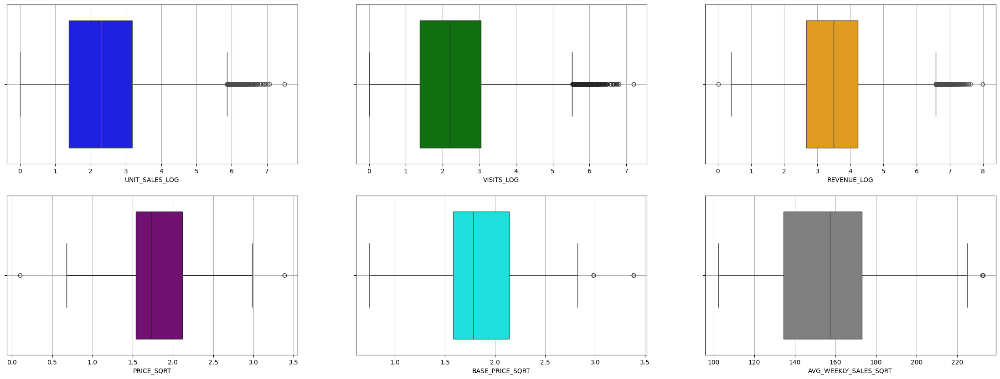

In [58]:
# Plot boxplot for log and sqrt transformed variables
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(28, 10))

sbn.boxplot(x=fmcg_sales_data['UNIT_SALES_LOG'], ax=ax[0,0], color='blue')
ax[0,0].grid(True)
sbn.boxplot(x=fmcg_sales_data['VISITS_LOG'], ax=ax[0,1], color='green')
ax[0,1].grid(True)
sbn.boxplot(x=fmcg_sales_data['REVENUE_LOG'], ax=ax[0,2], color='orange')
ax[0,2].grid(True)

sbn.boxplot(x=fmcg_sales_data['PRICE_SQRT'], ax=ax[1,0], color='purple')
ax[1,0].grid(True)
sbn.boxplot(x=fmcg_sales_data['BASE_PRICE_SQRT'], ax=ax[1,1], color='cyan')
ax[1,1].grid(True)
sbn.boxplot(x=fmcg_sales_data['AVG_WEEKLY_SALES_SQRT'], ax=ax[1,2], color='gray')
ax[1,2].grid(True)

##### Feature Engineering

###### YEAR, MONTH, WEEK_NUM

In [59]:
fmcg_sales_data.insert(1,'YEAR', fmcg_sales_data['WEEK_END_DATE'].dt.year)
fmcg_sales_data.insert(2,'MONTH', fmcg_sales_data['WEEK_END_DATE'].dt.month)
fmcg_sales_data.insert(3,'WEEK_NUM', fmcg_sales_data['WEEK_END_DATE'].dt.isocalendar().week)

###### DISCOUNT_RATE

In [60]:
fmcg_sales_data.insert(12, 'DISCOUNT_RATE', (fmcg_sales_data['BASE_PRICE'] - fmcg_sales_data['PRICE']) / fmcg_sales_data['BASE_PRICE'])

In [61]:
# transaction rows with negative discount rate (price > base price)
fmcg_sales_data[fmcg_sales_data['PRICE'] > fmcg_sales_data['BASE_PRICE']].sample(5)

,WEEK_END_DATE,YEAR,MONTH,WEEK_NUM,STORE_ID,UPC,UNIT_SALES,VISITS,HHS,REVENUE,...,SEG_VALUE_NAME,SALES_AREA_SIZE_NUM,AVG_WEEKLY_SALES,UNIT_SALES_LOG,VISITS_LOG,HHS_LOG,REVENUE_LOG,PRICE_SQRT,BASE_PRICE_SQRT,AVG_WEEKLY_SALES_SQRT
41537,2009-04-15,2009,4,16,13837,7192100336,10,10,10,65.90,...,MAINSTREAM,49164,27261.865385,2.302585,2.302585,2.302585,4.203199,2.567100,2.447448,165.111675
70920,2009-06-17,2009,6,25,23061,1111009507,33,22,22,55.44,...,MAINSTREAM,42437,16591.301282,3.496508,3.091042,3.091042,4.033178,1.296148,1.178983,128.807225
390136,2011-04-06,2011,4,14,4503,7797508004,11,10,10,32.89,...,MAINSTREAM,56230,25289.326923,2.397895,2.302585,2.302585,3.523120,1.729162,1.577973,159.026183
352542,2011-01-19,2011,1,3,15547,1111087398,3,2,2,15.36,...,MAINSTREAM,48132,27357.570513,1.098612,0.693147,0.693147,2.794839,2.262742,1.816590,165.401241
113964,2009-09-16,2009,9,38,25233,1111038078,11,10,10,17.38,...,VALUE,46369,35788.032051,2.397895,2.302585,2.302585,2.911263,1.256981,1.252996,189.177250


###### PROMOTION_SUPPORT

In [62]:
conditions = [
    (fmcg_sales_data['FEATURE'] == 0) & (fmcg_sales_data['DISPLAY'] == 0) & (fmcg_sales_data['TPR_ONLY'] == 0),
    (fmcg_sales_data['TPR_ONLY'] == 1),
    (fmcg_sales_data['FEATURE'] == 1) | (fmcg_sales_data['DISPLAY'] == 1)
]
values = ['NONE', 'UNSUPPORTED', 'SUPPORTED']

fmcg_sales_data.insert(16, 'PROMOTION_SUPPORT', np.select(conditions, values, default='No'))

###### SEG_VALUE_NAME_ORDINAL (Ordinal Encoding of SEG_VALUE_NAME)

In [63]:
from sklearn.preprocessing import OrdinalEncoder
encoder = OrdinalEncoder(categories=[['VALUE', 'MAINSTREAM', 'UPSCALE']])  # Define the encoder
fmcg_sales_data['SEG_VALUE_NAME_ORDINAL'] = encoder.fit_transform(fmcg_sales_data[['SEG_VALUE_NAME']]) # Fit and transform the data

In [64]:
fmcg_sales_data.sample(3)[['SEG_VALUE_NAME', 'SEG_VALUE_NAME_ORDINAL']]

,SEG_VALUE_NAME,SEG_VALUE_NAME_ORDINAL
167544,VALUE,0.0
181270,MAINSTREAM,1.0
354265,MAINSTREAM,1.0


#### Data Validation after Data Preprocessing

In [65]:
# Number of rows and columns after data pre-processing
fmcg_sales_data.shape

(524944, 37)

In [66]:
fmcg_sales_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 524944 entries, 0 to 524949
Data columns (total 37 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   WEEK_END_DATE            524944 non-null  datetime64[ns]
 1   YEAR                     524944 non-null  int32         
 2   MONTH                    524944 non-null  int32         
 3   WEEK_NUM                 524944 non-null  UInt32        
 4   STORE_ID                 524944 non-null  int64         
 5   UPC                      524944 non-null  int64         
 6   UNIT_SALES               524944 non-null  int64         
 7   VISITS                   524944 non-null  int64         
 8   HHS                      524944 non-null  int64         
 9   REVENUE                  524944 non-null  float64       
 10  PRICE                    524944 non-null  float64       
 11  BASE_PRICE               524944 non-null  float64       
 12  DISCOUNT_RATE        

### Data Sampling for Modeling

#### Remove rows for UPCs less than 10,000 counts

In [67]:
upc_counts = fmcg_sales_data['UPC'].value_counts()
upc_counts_less_10k = upc_counts[upc_counts < 10000]
print('Num of rows related to UPCs with less than 10,000 transaction records: ',  upc_counts_less_10k.sum())

subset_fmcg_sales_data = fmcg_sales_data[~fmcg_sales_data['UPC'].isin(upc_counts_less_10k.index)]
subset_fmcg_sales_data.shape

Num of rows related to UPCs with less than 10,000 transaction records:  109881


(415063, 37)

#### Remove rows with UNIT_SALES > 500

In [68]:
subset_fmcg_sales_data[['UNIT_SALES']].describe().transpose()

,count,mean,std,min,25%,50%,75%,max
UNIT_SALES,415063.0,22.851555,32.482429,1.0,6.0,13.0,28.0,1800.0


In [69]:
print('Num of rows with UNIT_SALES more than 500: ', len(subset_fmcg_sales_data[subset_fmcg_sales_data['UNIT_SALES'] > 500]))
subset_fmcg_sales_data = subset_fmcg_sales_data[subset_fmcg_sales_data['UNIT_SALES'] <= 500]
print(subset_fmcg_sales_data.shape)
subset_fmcg_sales_data[['UNIT_SALES']].describe().transpose()

Num of rows with UNIT_SALES more than 500:  116
(414947, 37)


,count,mean,std,min,25%,50%,75%,max
UNIT_SALES,414947.0,22.673857,30.555982,1.0,6.0,13.0,28.0,500.0


#### Remove STORE_ID and UPC pairs with less than 5 transaction records

In [70]:
unique_store_upc = subset_fmcg_sales_data[['STORE_ID', 'UPC']].drop_duplicates()
counts = subset_fmcg_sales_data.groupby(['STORE_ID', 'UPC']).size().reset_index(name='Counts')
unique_store_upc = unique_store_upc.merge(counts, on=['STORE_ID', 'UPC'])

store_upc_less5 = unique_store_upc[unique_store_upc['Counts'] < 5] 
display(store_upc_less5)
print('Num of rows with STORE_ID and UPC pairs less than 5 transaction records: ',  store_upc_less5['Counts'].sum())

,STORE_ID,UPC,Counts
33,387,1111038080,3
60,387,31254742725,4
2574,23055,1111038080,3


Num of rows with STORE_ID and UPC pairs less than 5 transaction records:  10


In [71]:
subset_fmcg_sales_data = subset_fmcg_sales_data[~subset_fmcg_sales_data.set_index(['STORE_ID', 'UPC']).index.
isin(store_upc_less5.set_index(['STORE_ID', 'UPC']).index)]
subset_fmcg_sales_data.shape

(414937, 37)

### Feature Selection for Modeling

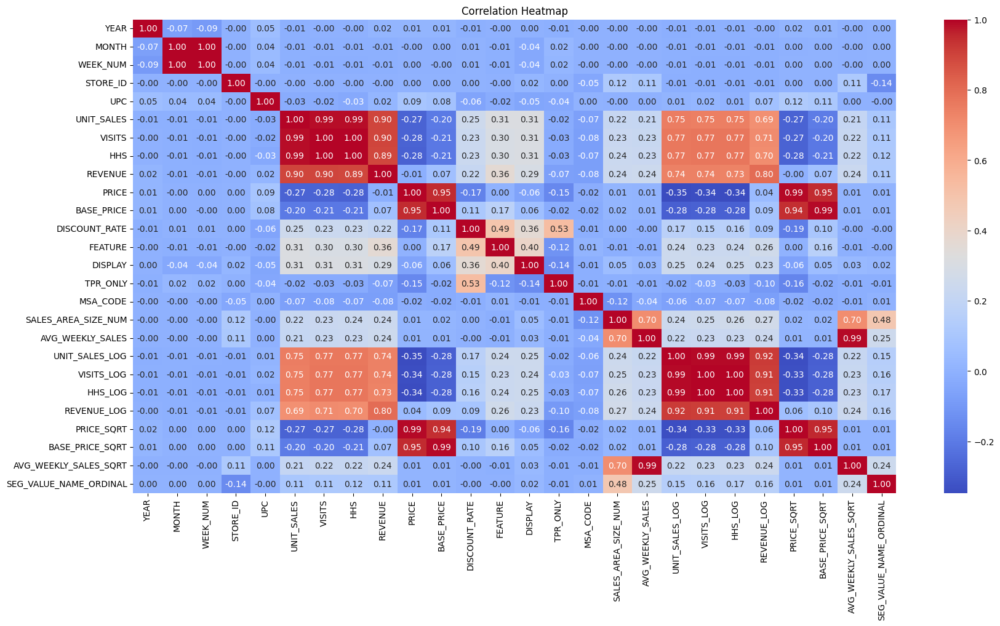

In [74]:
# Heatmap Correlation after performing all data proprocessing steps
# numeric_data = fmcg_sales_data.select_dtypes(include=['float64', 'int64', 'int32', 'UInt32'])
# correlation_matrix = subset_fmcg_sales_data.corr()
# plt.figure(figsize=(20,10)) 
# sbn.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")


numeric_data = subset_fmcg_sales_data.select_dtypes(include=['float64', 'int64', 'int32', 'UInt32'])

# Compute the correlation matrix
correlation_matrix = numeric_data.corr()

# Plot the heatmap
plt.figure(figsize=(20, 10))
sbn.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()






In [75]:
# Drop multicollinear variables with correlation = 1
subset_fmcg_sales_data.drop(columns=['MONTH','HHS','HHS_LOG'], inplace=True)

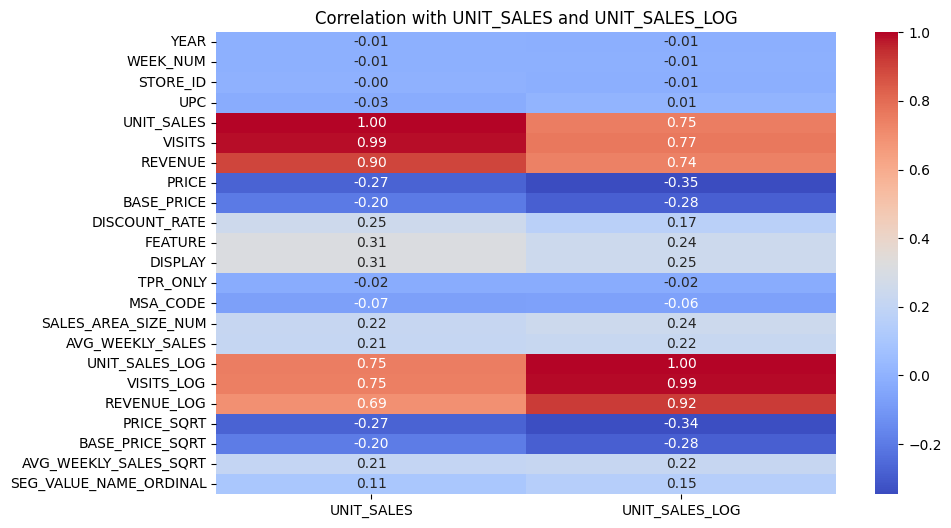

In [76]:
numeric_data = subset_fmcg_sales_data.select_dtypes(include=['float64', 'int64', 'int32', 'UInt32'])
plt.figure(figsize=(10, 6))
sbn.heatmap(numeric_data.corr()[['UNIT_SALES', 'UNIT_SALES_LOG']], annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation with UNIT_SALES and UNIT_SALES_LOG')
plt.show()

In [77]:
subset_fmcg_sales_data.select_dtypes(include=['object']).columns

Index(['PROMOTION_SUPPORT', 'DESCRIPTION', 'MANUFACTURER', 'CATEGORY',
       'SUB_CATEGORY', 'PRODUCT_SIZE', 'STORE_NAME', 'ADDRESS_CITY_NAME',
       'ADDRESS_STATE_PROV_CODE', 'SEG_VALUE_NAME'],
      dtype='object')

In [78]:
# Select features
final_subset = subset_fmcg_sales_data[['WEEK_END_DATE','YEAR','WEEK_NUM','STORE_ID','UPC', 
                                        'UNIT_SALES','UNIT_SALES_LOG','PRICE','PRICE_SQRT','BASE_PRICE','BASE_PRICE_SQRT',
                                        'DISCOUNT_RATE','FEATURE','DISPLAY','PROMOTION_SUPPORT',
                                        'CATEGORY','SUB_CATEGORY','STORE_NAME','SEG_VALUE_NAME', 'SEG_VALUE_NAME_ORDINAL','SALES_AREA_SIZE_NUM']]

# Data dimension of final_subset
print(final_subset.shape)

# Save the final_subset into Excel file for further modeling purpose
#final_subset.to_excel('Dataset/FINAL SUBSET_preprocessed_data.xlsx', index=False)

(414937, 21)


### Data Exploration/Visualization

#### Sales Transaction Count by WEEK_END_DATE

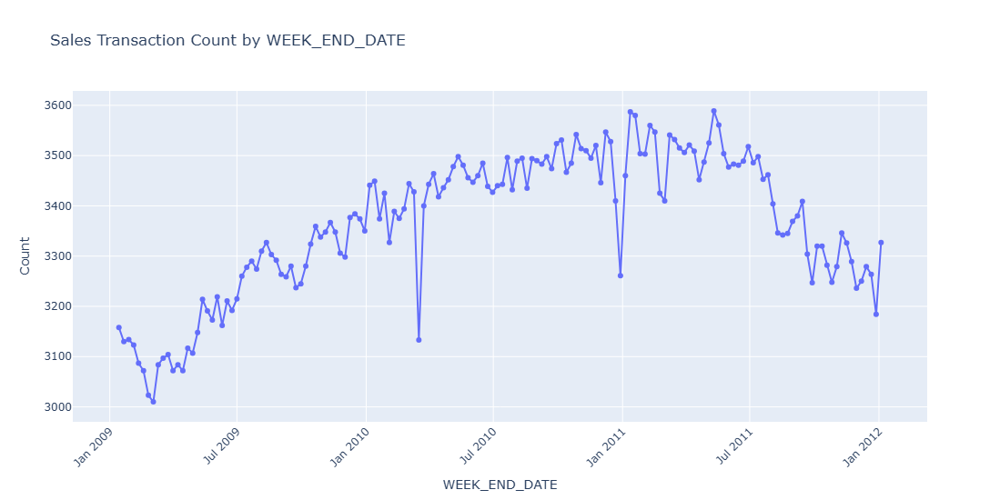

In [79]:
date_counts = fmcg_sales_data['WEEK_END_DATE'].value_counts().sort_index() # Count occurrences of each 'WEEK_END_DATE'
fig = go.Figure()
fig.add_trace(go.Scatter(x=date_counts.index, y=date_counts.values, mode='lines+markers'))
fig.update_layout(title='Sales Transaction Count by WEEK_END_DATE',
                  xaxis_title='WEEK_END_DATE',
                  yaxis_title='Count',
                  xaxis=dict(tickangle=-45),
                  width=1500, height=550)
fig.show()

#### Total UNIT_SALES, VISITS, and REVENUE by WEEK_END_DATE

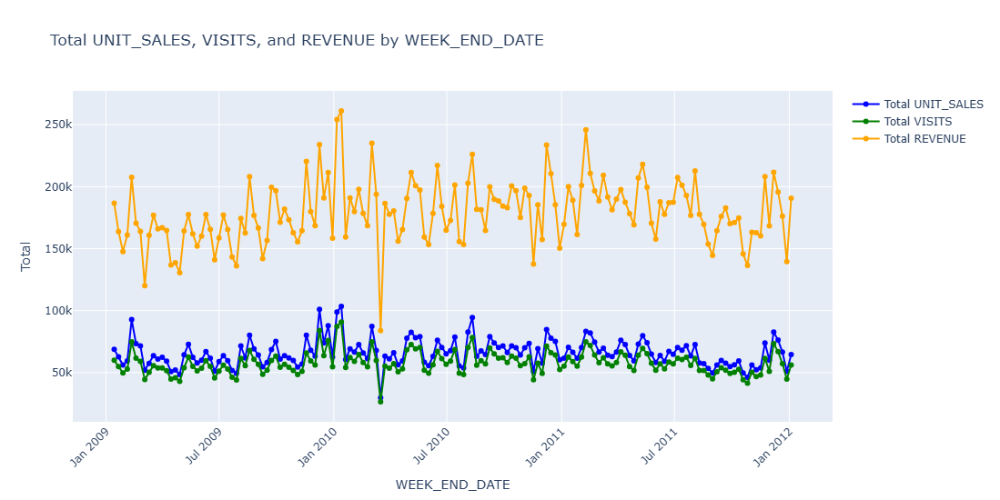

In [80]:
sales_by_date = fmcg_sales_data.groupby('WEEK_END_DATE').agg({'UNIT_SALES': 'sum', 'VISITS': 'sum', 'REVENUE': 'sum'})

fig = go.Figure()
fig.add_trace(go.Scatter(x=sales_by_date.index, y=sales_by_date['UNIT_SALES'], mode='lines+markers', name='Total UNIT_SALES', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=sales_by_date.index, y=sales_by_date['VISITS'], mode='lines+markers', name='Total VISITS', line=dict(color='green')))
fig.add_trace(go.Scatter(x=sales_by_date.index, y=sales_by_date['REVENUE'], mode='lines+markers', name='Total REVENUE', line=dict(color='orange')))

fig.update_layout(title='Total UNIT_SALES, VISITS, and REVENUE by WEEK_END_DATE',
                  xaxis_title='WEEK_END_DATE',
                  yaxis_title='Total',
                  xaxis=dict(tickangle=-45),
                  width=1500, height=550)
fig.show()


#### Average UNIT_SALES, VISITS, and REVENUE by WEEK_NUM

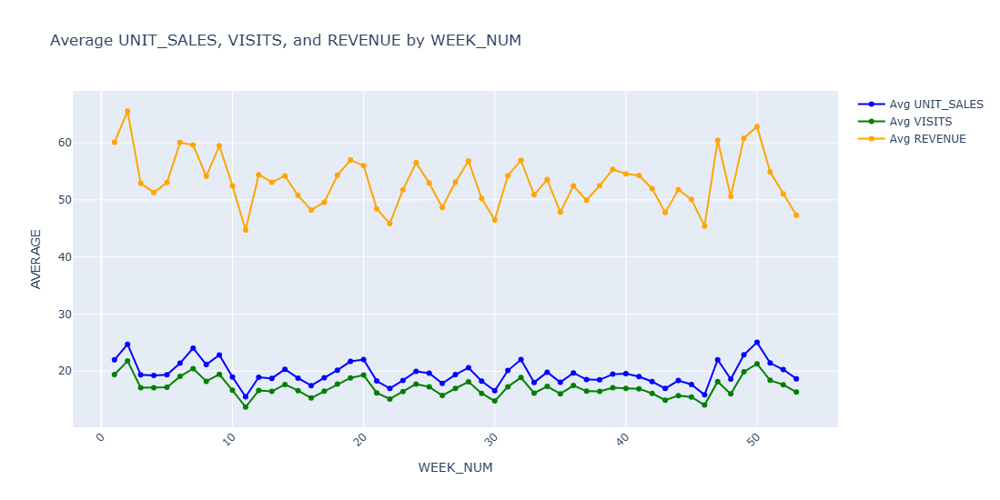

In [81]:
#Average UNIT_SALES, VISITS, and REVENUE by MONTH
# sales_by_month = fmcg_sales_data.groupby('MONTH').agg({'UNIT_SALES': 'mean', 'VISITS': 'mean', 'REVENUE': 'mean'})
sales_by_week_num = fmcg_sales_data.groupby('WEEK_NUM').agg({'UNIT_SALES': 'mean', 'VISITS': 'mean', 'REVENUE': 'mean'})
fig = go.Figure()
fig.add_trace(go.Scatter(x=sales_by_week_num.index, y=sales_by_week_num['UNIT_SALES'], mode='lines+markers', name='Avg UNIT_SALES', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=sales_by_week_num.index, y=sales_by_week_num['VISITS'], mode='lines+markers', name='Avg VISITS', line=dict(color='green')))
fig.add_trace(go.Scatter(x=sales_by_week_num.index, y=sales_by_week_num['REVENUE'], mode='lines+markers', name='Avg REVENUE', line=dict(color='orange')))

fig.update_layout(title='Average UNIT_SALES, VISITS, and REVENUE by WEEK_NUM',
                  xaxis_title='WEEK_NUM',
                  yaxis_title='AVERAGE',
                  xaxis=dict(tickangle=-45),
                  width=1500, height=550)
fig.show()

#### Count of FEATURE, DISPLAY, TPR_ONLY

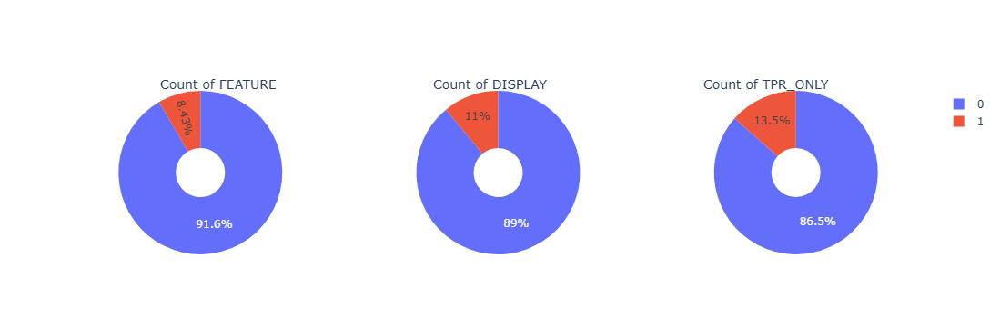

In [82]:
label = [0, 1]
fig = go.Figure()
fig.add_trace(go.Pie(labels=label, values=fmcg_sales_data['FEATURE'].value_counts(),
                     name='FEATURE', hole=0.3, domain={'x': [0, 0.3]}))
fig.add_trace(go.Pie(labels=label, values=fmcg_sales_data['DISPLAY'].value_counts(),
                     name='DISPLAY', hole=0.3, domain={'x': [0.35, 0.65]}))
fig.add_trace(go.Pie(labels=label, values=fmcg_sales_data['TPR_ONLY'].value_counts(),
                     name='TPR_ONLY', hole=0.3, domain={'x': [0.7, 1.0]}))

fig.update_layout(
    annotations=[
        dict(text='Count of FEATURE', x=0.1, y=1.1, font_size=14, showarrow=False),
        dict(text='Count of DISPLAY', x=0.49, y=1.1, font_size=14, showarrow=False),
        dict(text='Count of TPR_ONLY', x=0.89, y=1.1, font_size=14, showarrow=False)
    ]
)
fig.show()

#### Count of SUB_CATEGORY by CATEGORY

<Figure size 2000x2000 with 0 Axes>

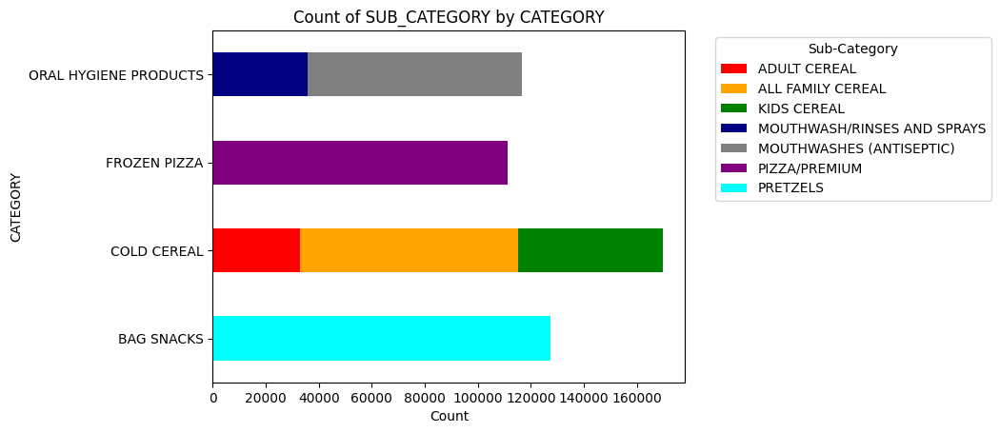

In [83]:
subcategory_counts = fmcg_sales_data.groupby(['CATEGORY', 'SUB_CATEGORY']).size().sort_values(ascending=False)
plt.figure(figsize=(20, 20))
subcategory_counts.unstack().plot(kind='barh', stacked=True, color=['red', 'orange', 'green', 'navy', 'gray', 'purple','cyan'])
plt.xlabel('Count')
plt.ylabel('CATEGORY')
plt.title('Count of SUB_CATEGORY by CATEGORY')
plt.legend(title='Sub-Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [84]:
subcategory_counts_table = fmcg_sales_data.groupby(['CATEGORY', 'SUB_CATEGORY']).size().reset_index(name='COUNT')
subcategory_counts_table

,CATEGORY,SUB_CATEGORY,COUNT
0,BAG SNACKS,PRETZELS,127461
1,COLD CEREAL,ADULT CEREAL,32993
2,COLD CEREAL,ALL FAMILY CEREAL,82006
3,COLD CEREAL,KIDS CEREAL,54689
4,FROZEN PIZZA,PIZZA/PREMIUM,111270
5,ORAL HYGIENE PRODUCTS,MOUTHWASH/RINSES AND SPRAYS,35705
6,ORAL HYGIENE PRODUCTS,MOUTHWASHES (ANTISEPTIC),80820


#### Count of PROMOTION_SUPPORT by CATEGORY

<Figure size 2000x2000 with 0 Axes>

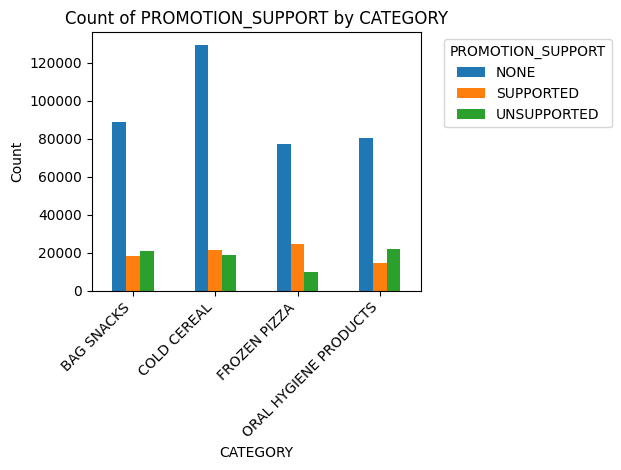

In [85]:
promotion_counts = fmcg_sales_data.groupby(['CATEGORY', 'PROMOTION_SUPPORT']).size().unstack(fill_value=0)
plt.figure(figsize=(20, 20))
promotion_counts.plot(kind='bar', stacked=False)
plt.xlabel('CATEGORY')
plt.ylabel('Count')
plt.title('Count of PROMOTION_SUPPORT by CATEGORY')
plt.legend(title='PROMOTION_SUPPORT', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [86]:
promotion_support_counts = fmcg_sales_data.groupby(['CATEGORY', 'PROMOTION_SUPPORT']).size().reset_index(name='COUNT')
promotion_support_counts

,CATEGORY,PROMOTION_SUPPORT,COUNT
0,BAG SNACKS,NONE,88720
1,BAG SNACKS,SUPPORTED,17993
2,BAG SNACKS,UNSUPPORTED,20748
3,COLD CEREAL,NONE,129472
4,COLD CEREAL,SUPPORTED,21597
5,COLD CEREAL,UNSUPPORTED,18619
6,FROZEN PIZZA,NONE,77155
7,FROZEN PIZZA,SUPPORTED,24517
8,FROZEN PIZZA,UNSUPPORTED,9598
9,ORAL HYGIENE PRODUCTS,NONE,80212


#### Count of SEG_VALUE_NAME

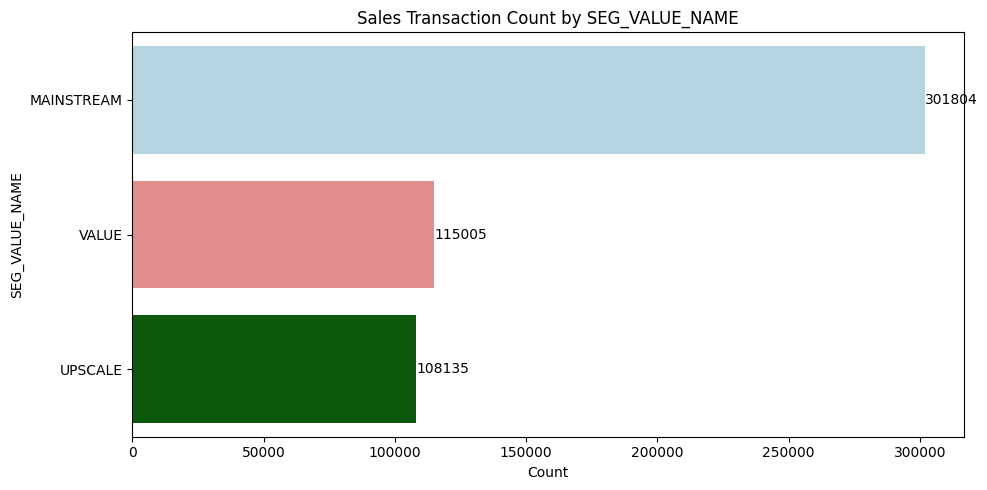

In [92]:
import seaborn as sbn
import matplotlib.pyplot as plt

# Check if the column exists and has valid data
if 'SEG_VALUE_NAME' in fmcg_sales_data.columns and not fmcg_sales_data['SEG_VALUE_NAME'].empty:
    # Define colors for the categories
    colors = {'VALUE': 'lightcoral', 'MAINSTREAM': 'lightblue', 'UPSCALE': 'darkgreen'}
    
    # Get order of categories by frequency
    order = fmcg_sales_data['SEG_VALUE_NAME'].value_counts(ascending=False).index
    
    # Create the plot
    plt.figure(figsize=(10, 5))
    plt.title('Sales Transaction Count by SEG_VALUE_NAME')
    
    # Create the countplot with explicit hue alignment
    ax = sbn.countplot(
        y='SEG_VALUE_NAME',
        data=fmcg_sales_data,
        order=order,
        hue='SEG_VALUE_NAME',  # Required for palette without FutureWarning
        hue_order=order,       # Align hue order with y-axis order
        palette=colors,
        legend=False           # Disable redundant legend
    )
    
    # Add bar labels safely
    if ax.containers:
        # Get counts in the order of the plot
        counts = fmcg_sales_data['SEG_VALUE_NAME'].value_counts(ascending=False).values
        
        # Assign one label per container (each container has one bar)
        for container, count in zip(ax.containers, counts):
            ax.bar_label(container, labels=[count], label_type='edge')
    
    plt.xlabel("Count")
    plt.ylabel("SEG_VALUE_NAME")
    plt.tight_layout()
    plt.show()
else:
    print("Error: 'SEG_VALUE_NAME' column is missing or empty.")

#### Average UNIT_SALES by SEG_VALUE_NAME 

C:\Users\deepa\AppData\Local\Temp\ipykernel_20452\108541877.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




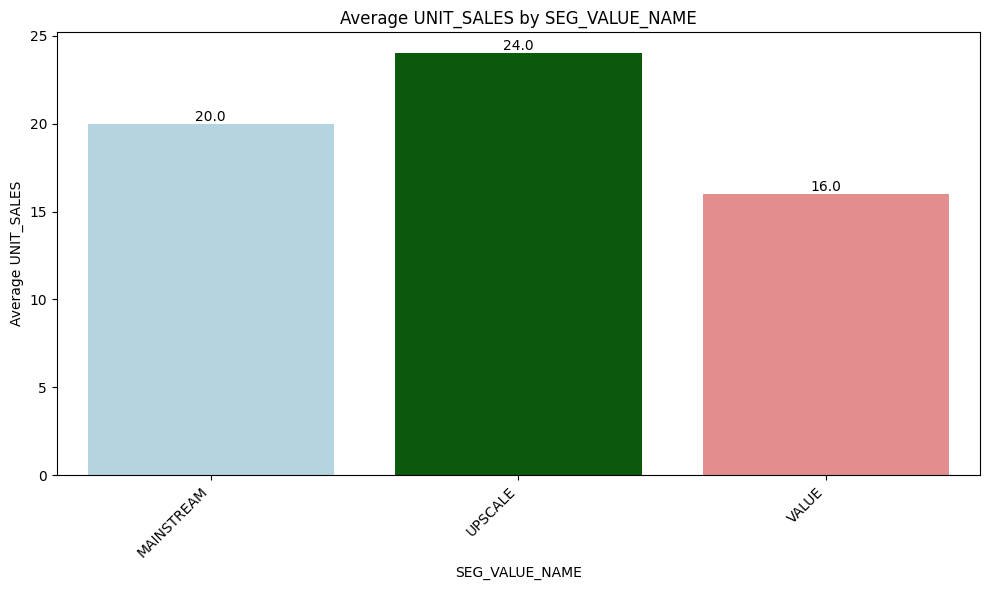

In [95]:
avg_unit_sales = fmcg_sales_data.groupby('SEG_VALUE_NAME')['UNIT_SALES'].mean().round().reset_index()
plt.figure(figsize=(10, 6))

ax = sbn.barplot(x=avg_unit_sales["SEG_VALUE_NAME"], y=avg_unit_sales["UNIT_SALES"], palette=[colors[val] for val in avg_unit_sales["SEG_VALUE_NAME"]])

for container, label in zip(ax.containers, avg_unit_sales['UNIT_SALES']):
    ax.bar_label(container, labels=[label], label_type='edge')

plt.title('Average UNIT_SALES by SEG_VALUE_NAME')
plt.xlabel('SEG_VALUE_NAME')
plt.ylabel('Average UNIT_SALES')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### Average REVENUE by SEG_VALUE_NAME

C:\Users\deepa\AppData\Local\Temp\ipykernel_20452\2018780232.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




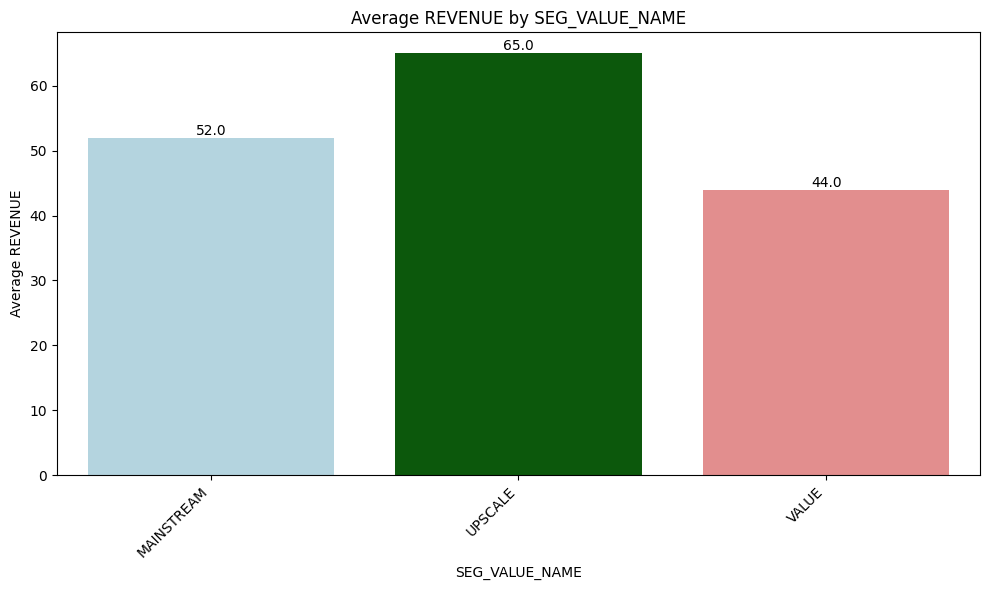

In [96]:
avg_revenue = fmcg_sales_data.groupby('SEG_VALUE_NAME')['REVENUE'].mean().round().reset_index()
plt.figure(figsize=(10, 6))

ax = sbn.barplot(x=avg_revenue["SEG_VALUE_NAME"], y=avg_revenue["REVENUE"], palette=[colors[val] for val in avg_unit_sales["SEG_VALUE_NAME"]])

for container, label in zip(ax.containers, avg_revenue['REVENUE']):
    ax.bar_label(container, labels=[label], label_type='edge')

plt.title('Average REVENUE by SEG_VALUE_NAME')
plt.xlabel('SEG_VALUE_NAME')
plt.ylabel('Average REVENUE')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#### Distribution of PRICE by CATEGORY

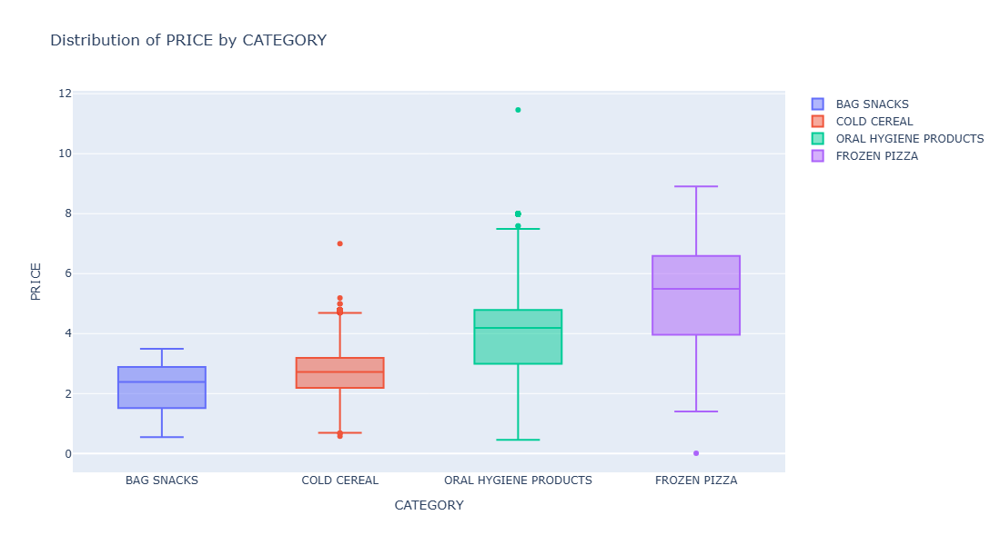

In [97]:
specified_order = ['BAG SNACKS', 'COLD CEREAL', 'ORAL HYGIENE PRODUCTS', 'FROZEN PIZZA']
fig = go.Figure()

for category in specified_order:
    if category in fmcg_sales_data['CATEGORY'].unique():
        fig.add_trace(go.Box(y=fmcg_sales_data[fmcg_sales_data['CATEGORY'] == category]['PRICE'], name=category))

fig.update_layout(title='Distribution of PRICE by CATEGORY',
                  xaxis_title='CATEGORY',
                  yaxis_title='PRICE',
                  width=1000, height=600)
fig.show()

#### Distribution of PRICE by SUB_CATEGORY

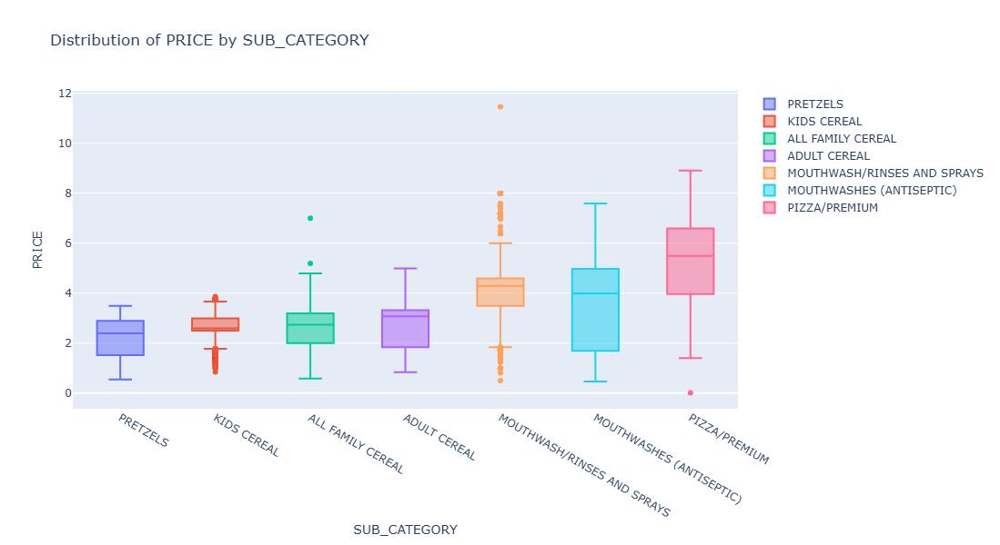

In [98]:
specified_order = ['PRETZELS', 'KIDS CEREAL', 'ALL FAMILY CEREAL', 'ADULT CEREAL', 'MOUTHWASH/RINSES AND SPRAYS', 'MOUTHWASHES (ANTISEPTIC)', 'PIZZA/PREMIUM']
fig = go.Figure()

for subcategory in specified_order:
    if subcategory in fmcg_sales_data['SUB_CATEGORY'].unique():
        fig.add_trace(go.Box(y=fmcg_sales_data[fmcg_sales_data['SUB_CATEGORY'] == subcategory]['PRICE'], name=subcategory))

fig.update_layout(title='Distribution of PRICE by SUB_CATEGORY',
                  xaxis_title='SUB_CATEGORY',
                  yaxis_title='PRICE',
                  width=1500, height=600)
fig.show()

#### Distribution of DISCOUNT_RATE by SEG_VALUE_NAME

C:\Users\deepa\AppData\Local\Temp\ipykernel_20452\2535161020.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




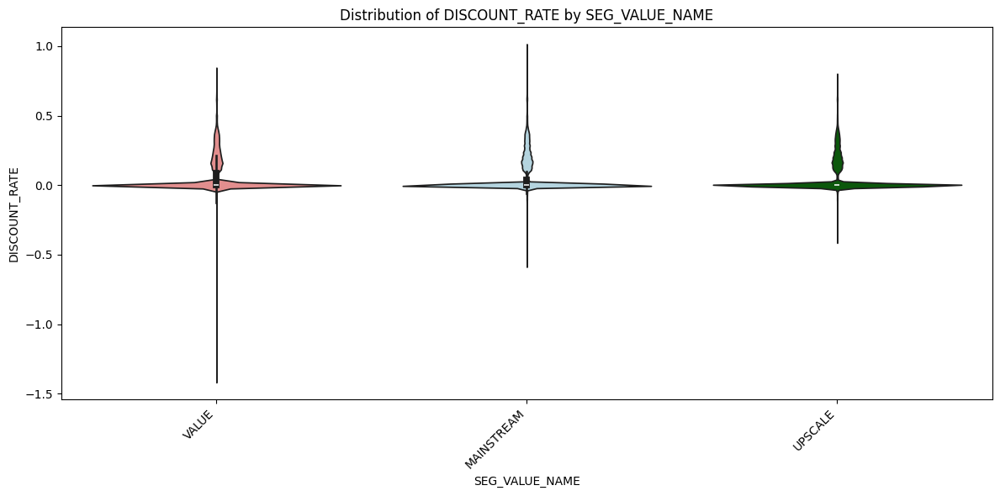

In [100]:
plt.figure(figsize=(12, 6))
sbn.violinplot(
    x=fmcg_sales_data['SEG_VALUE_NAME'], 
    y=fmcg_sales_data['DISCOUNT_RATE'],
    palette=colors,
    order=['VALUE', 'MAINSTREAM', 'UPSCALE']  # Use `order` instead of `categories`
)
plt.title('Distribution of DISCOUNT_RATE by SEG_VALUE_NAME')
plt.xlabel('SEG_VALUE_NAME')
plt.ylabel('DISCOUNT_RATE')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [101]:
df = fmcg_sales_data.groupby('SEG_VALUE_NAME')['DISCOUNT_RATE'].describe()
df = df.reindex(['VALUE', 'MAINSTREAM', 'UPSCALE'])
df

,count,mean,std,min,25%,50%,75%,max
SEG_VALUE_NAME,,,,,,,,
VALUE,115005.0,0.060108,0.117671,-1.397260,0.0,0.0,0.085227,0.822394
MAINSTREAM,301804.0,0.057333,0.114510,-0.570571,0.0,0.0,0.040161,0.996923
UPSCALE,108135.0,0.053715,0.109808,-0.393939,0.0,0.0,0.000000,0.780488


In [102]:
df.head()

,count,mean,std,min,25%,50%,75%,max
SEG_VALUE_NAME,,,,,,,,
VALUE,115005.0,0.060108,0.117671,-1.397260,0.0,0.0,0.085227,0.822394
MAINSTREAM,301804.0,0.057333,0.114510,-0.570571,0.0,0.0,0.040161,0.996923
UPSCALE,108135.0,0.053715,0.109808,-0.393939,0.0,0.0,0.000000,0.780488


In [103]:
final_subset.to_csv('final_subset.csv', index=False)